# Using Scanpy to perform QC and UMAP projection

## Load Scanpy as the main library we will use (together with anndata) to process our data

In [5]:
import numpy as np
import pandas as pd
import anndata as ad
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
#import scvelo as scv
#import palantir
from sklearn.neighbors import NearestNeighbors #pip install scikit-learn
from sklearn.metrics import DistanceMetric
from sklearn.decomposition import PCA
#from kneed import KneeLocator as kl #pip install kneed
from pathlib import Path
# verbosity: errors (0), warnings (1), info (2), hints (3)

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
#sc.logging.print_versions()
sc.set_figure_params(dpi=100, frameon=True, figsize=None, facecolor="white")


## Read the MEX matrix given by CellRanger

In [2]:
samples = {
#   "hESC": "hESC/mex",
    "Ctrl 24h": "mp_24h/mex",
    "Ctrl 60h": "mp_60h_ctrl/mex",
#  "Ctrl 96h": "mp_96h_ctrl/mex",
    "SL24h": "mp_60h_sl24h/mex",
#   "SL0h": "mp_60h_sl0h/mex",
}

annotations = {
#   "hESC": "hESC/predictions/hESC.tsv",
    "Ctrl 24h":"mp_24h/predictions/mp_24h.tsv",
    "Ctrl 60h": "mp_60h_ctrl/predictions/mp_60h_ctrl.tsv",
#   "Ctrl 96h": "mp_96h_ctrl/predictions/mp_96h_ctrl.tsv",
    "SL24h": "mp_60h_sl24h/predictions/mp_60h_sl24h.tsv",
#   "SL0h": "mp_60h_sl0h/predictions/mp_60h_sl0h.tsv",
    
}

adatas = {}

for sample_id, filename in samples.items():
    
    print("Loading annotations for " + sample_id)
    
    # Load the cell type annotations from Petropoulos embryogenesis prediction tool
    df = pd.read_csv(annotations[sample_id], sep = "\t")
    # Ensure the first column is used as index
    df = df.set_index(['query_cell'])

    
    # Load MEX
    print("Loading MEX for " + sample_id)
    sample_adata = sc.read_10x_mtx(filename, cache=True)
        
    # Add annotations to the annData object
    print("Merging annData object with cell type annotations")
    sample_adata.obs = sample_adata.obs.merge(how='left',right=df, left_index=True, right_index=True)
    
    
    # Filter out cells with NA in pred_EML
    print("Filtering out unclassified cells")
    sample_adata = sample_adata[~sample_adata.obs['pred_EML'].isna()]
    # Comment to use the whole dataset
    #sc.pp.subsample(sample_adata, n_obs=1000)
        
    sample_adata.var_names_make_unique()
    adatas[sample_id] = sample_adata
    print(sample_id + " done")

Loading annotations for Ctrl 24h
Loading MEX for Ctrl 24h
... reading from cache file cache/mp_24h-mex-matrix.h5ad
Merging annData object with cell type annotations
Filtering out unclassified cells
Ctrl 24h done
Loading annotations for Ctrl 60h
Loading MEX for Ctrl 60h
... reading from cache file cache/mp_60h_ctrl-mex-matrix.h5ad
Merging annData object with cell type annotations
Filtering out unclassified cells
Ctrl 60h done
Loading annotations for SL24h
Loading MEX for SL24h
... reading from cache file cache/mp_60h_sl24h-mex-matrix.h5ad
Merging annData object with cell type annotations
Filtering out unclassified cells
SL24h done


In [3]:
"""
#Aswin
#loading tyser data
adata_in = sc.read_mtx("tyser_data/raw_counts.mtx")
umap_meta = pd.read_csv("tyser_data/umap_meta.csv")
adata_in.obs = umap_meta
adata_in.obsm["X_umap"] = umap_meta[["X0","X1"]].values
"""

'\n#Aswin\n#loading tyser data\nadata_in = sc.read_mtx("tyser_data/raw_counts.mtx")\numap_meta = pd.read_csv("tyser_data/umap_meta.csv")\nadata_in.obs = umap_meta\nadata_in.obsm["X_umap"] = umap_meta[["X0","X1"]].values\n'

In [4]:
adata = ad.concat(adatas, label="sample")
adata.obs_names_make_unique()

/Users/aswinkumaar/anaconda3/lib/python3.11/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [5]:
## Check the shape of the anndata object

In [6]:
n_cells = adata.n_obs  # Alternative to adata.shape[0]
print(f"Number of cells: {n_cells}")

Number of cells: 20998


In [7]:
adata.X

<20998x18099 sparse matrix of type '<class 'numpy.float32'>'
	with 120186704 stored elements in Compressed Sparse Row format>

In [8]:
adata

AnnData object with n_obs × n_vars = 20998 × 18099
    obs: 'pred_EML', 'sub_pred_EML', 'stage', 'prediction_score_max', 'pred_psdt', 'sample'

In [9]:
"""
#Aswin
adata_in
"""

'\n#Aswin\nadata_in\n'

In [10]:
# Show the first 10  genes
print("The first 10 genes are: ")
print(adata.var_names[:10])
# Show the first 10 cells
print("\nThe first 10 cells are: ")
print(adata.obs_names[:10])
# Show the unique annotations obtained from the Petropoulos tool
print("\nThe number of cell types identified by the Petropoulos tool are: ")
print(adata.obs["pred_EML"].nunique())
print("\nThe cell types identified are: ")
print(adata.obs["pred_EML"].unique())

The first 10 genes are: 
Index(['SAMD11', 'NOC2L', 'KLHL17', 'PLEKHN1', 'PERM1', 'HES4', 'ISG15',
       'AGRN', 'RNF223', 'C1orf159'],
      dtype='object')

The first 10 cells are: 
Index(['AAACAAGCAAACCCAAACTTTAGG-1', 'AAACAAGCAAATACCGACTTTAGG-1',
       'AAACAAGCAATGTGGCACTTTAGG-1', 'AAACAAGCACACTGGGACTTTAGG-1',
       'AAACAAGCACATAAACACTTTAGG-1', 'AAACAAGCACATAGTGACTTTAGG-1',
       'AAACAAGCACTATGGAACTTTAGG-1', 'AAACAAGCAGCCTATTACTTTAGG-1',
       'AAACAAGCATGACCAAACTTTAGG-1', 'AAACAAGCATGAGTCAACTTTAGG-1'],
      dtype='object')

The number of cell types identified by the Petropoulos tool are: 
9

The cell types identified are: 
['Epiblast' 'nb_failed' 'low_cor' 'Ambiguous' 'PriS' 'AdvMes' 'DE'
 'Mesoderm' 'Hypoblast']


## Start the quality control. We will do QC for each sample separately.

#### Filter cells based on number of detected genes, number of total counts and rate of mitochondrial genes

##### This basically adds a note on each cell, where it says discard (True or False). This way the QC metric can be checked at the end. 

In [11]:
# mitochondrial genes, "MT-" for human, "Mt-" for mouse
adata.var["mt"] = adata.var_names.str.startswith("MT-")
# ribosomal genes
adata.var["ribo"] = adata.var_names.str.startswith(("RPS", "RPL"))
# hemoglobin genes
adata.var["hb"] = adata.var_names.str.contains("^HB[^(P)]")


sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt", "ribo", "hb"], inplace=True, log1p=True
)

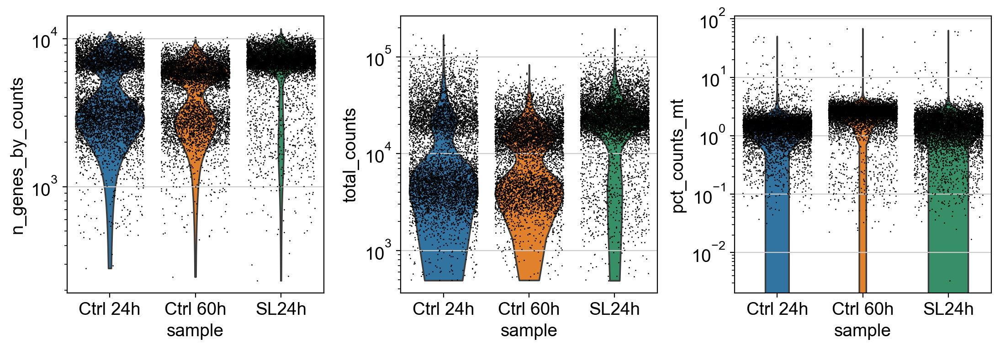

In [12]:
sc.pl.violin(
    adata,
    # adata[adata.obs["sample"]=="SL0h 60h"],
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
    groupby='sample',
    log = True
)

In [13]:
# Ensure 'sample' is a categorical variable
adata.obs["sample"] = adata.obs["sample"].astype("category")

# Define per-sample thresholds
qc_thresholds = {
    "Ctrl 24h": {"min_genes"  : 4500,
                 "max_genes"  : 11000,
                 "min_counts" : 7000, 
                 "max_counts" : 80000,
                 "max_mt": 5},
   "Ctrl 60h":  {"min_genes"  : 3500,
                 "max_genes"  : 10000,
                 "min_counts" : 6000,
                 "max_counts" : 70000,
                 "max_mt": 6},
    "SL24h":    {"min_genes"  : 4500,
                 "max_genes"  : 11500,
                 "min_counts" : 10000,
                 "max_counts" : 80000,
                 "max_mt": 5},
}

# Create an empty list to store discard flags
discard_flags = []
filtered_adata = adata

# Create a combined discard mask across all samples
combined_discard_mask = pd.Series([False] * filtered_adata.shape[0], index=filtered_adata.obs.index)

for sample, thresholds in qc_thresholds.items():
    subset = filtered_adata.obs["sample"] == sample
    
    # Generate boolean masks for each condition (for each threshold)
    mask_fail_genes = (filtered_adata.obs["n_genes_by_counts"] < thresholds["min_genes"]) | (filtered_adata.obs["n_genes_by_counts"] > thresholds["max_genes"])
    mask_fail_counts = (filtered_adata.obs["total_counts"] < thresholds["min_counts"]) | (filtered_adata.obs["total_counts"] > thresholds["max_counts"])
    mask_fail_mt = (filtered_adata.obs["pct_counts_mt"] > thresholds["max_mt"])
    
    # Combine all failures using OR condition (if any of the conditions is True, mark for discard)
    discard_mask = mask_fail_genes | mask_fail_counts | mask_fail_mt
    
    # Combine all failures using AND condition (only if all conditions are True, mark for discard)
    #discard_mask = mask_fail_genes & mask_fail_mt | mask_fail_counts
    
    # Combine the discard mask for the current sample with the overall discard mask
    combined_discard_mask = combined_discard_mask | discard_mask

# Assign the combined discard mask to the single 'discard' column
filtered_adata.obs["discard"] = combined_discard_mask

In [14]:
print(adata.obs["discard"].value_counts())

discard
False    13943
True      7055
Name: count, dtype: int64


In [15]:
# make a copy of the anndata data
aadata = adata

In [16]:
# Keep only cells that are NOT marked for discard
adata = filtered_adata[~filtered_adata.obs["discard"]].copy()

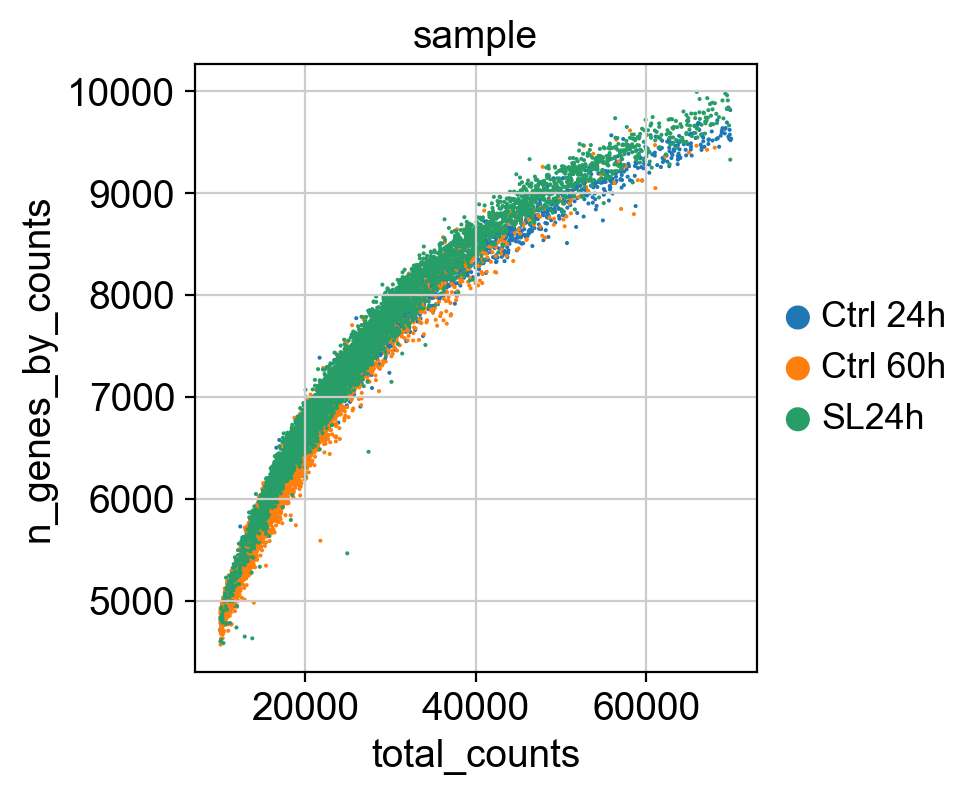

In [17]:
sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="sample")# Keep only cells that are NOT marked for discard
adata = filtered_adata[~filtered_adata.obs["discard"]].copy()

#### Identify cell cycle genes. 

Done as in doi: 10.1038/s41586-022-05655-4 
For now I use the file they had for cell cycle genes, this was obtained from the Regev lab

In [18]:
cell_cycle_genes = [x.strip() for x in open('regev_lab_cell_cycle_genes.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    514 total control genes are used. (0:00:01)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    385 total control genes are used. (0:00:01)
-->     'phase', cell cycle phase (adata.obs)


In [19]:
adata.raw= adata

### Doublet detection

In [20]:
sc.pp.scrublet(adata, batch_key="sample")

Running Scrublet
filtered out 2534 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    using data matrix X directly
Automatically set threshold at doublet score = 0.49
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%
filtered out 2552 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.

## Normalization

In [21]:
# Saving count data
adata.layers["counts"] = adata.X.copy()

In [22]:
# normalize counts to 10,000 reads per cell..
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


In [23]:
#log n+1 transform
sc.pp.log1p(adata)

#### Identify highly variable genes

In [24]:
# identify highly variable genes
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [25]:
# Count the number of highly variable genes
num_hvg = adata.var["highly_variable"].sum()

# Print the result
print(f"Number of highly variable genes: {num_hvg}")

Number of highly variable genes: 1928


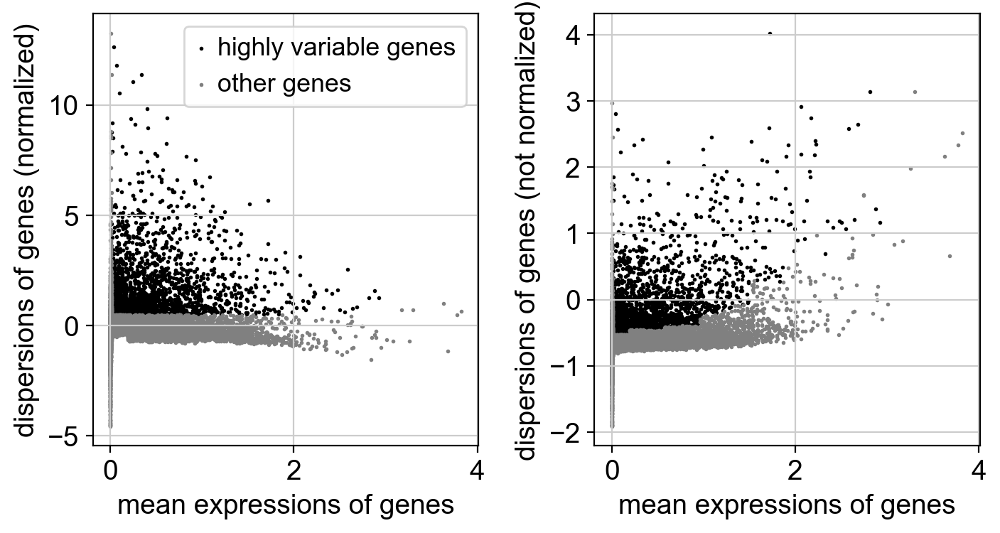

In [26]:
#plot dispersion vs expression
sc.pl.highly_variable_genes(adata)

In [27]:
adata.raw = adata

#### Remove the effects of confounding variables

In [28]:
# Removes the influence of the cell cycle phase (S-phase and G2M-phase) from gene expression.
sc.pp.regress_out(adata, ['S_score', 'G2M_score'], n_jobs = 16)

regressing out ['S_score', 'G2M_score']
    sparse input is densified and may lead to high memory use
    finished (0:00:05)


#### Scale the data

In [29]:
# scale to unit variance for PCA, clip values exceding var 10
# Centers & scales genes, clips outliers
sc.pp.scale(adata, max_value=10)

#### Compute PCA

In [30]:
# reduce the dimensionality of the data with PCA
# 'arpack' is a specific method for computing PCA (useful for sparse data).
sc.tl.pca(adata)#, svd_solver='arpack')

computing PCA
    with n_comps=50
    finished (0:00:19)


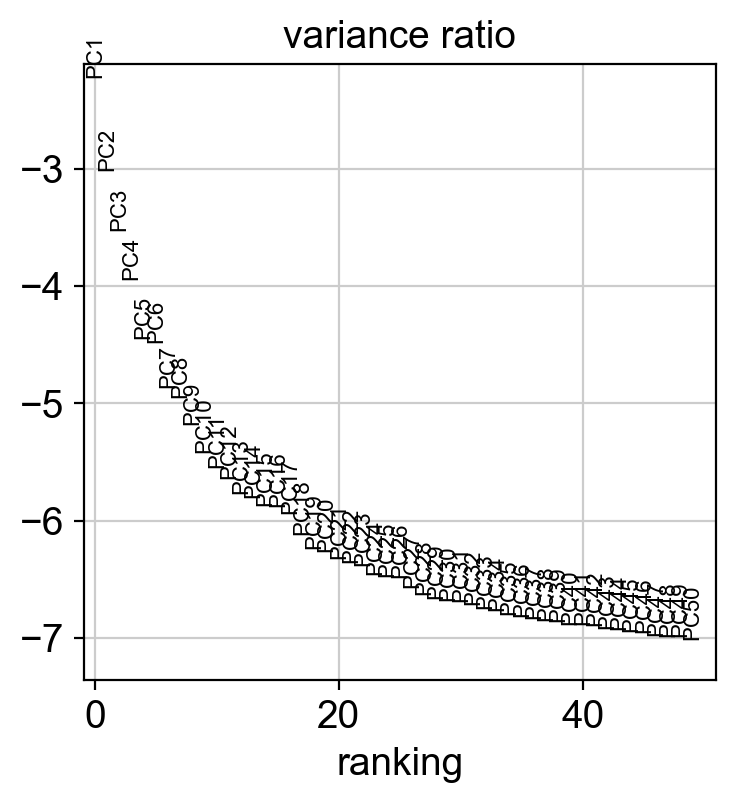

In [31]:
sc.pl.pca_variance_ratio(adata, n_pcs=50, log=True)

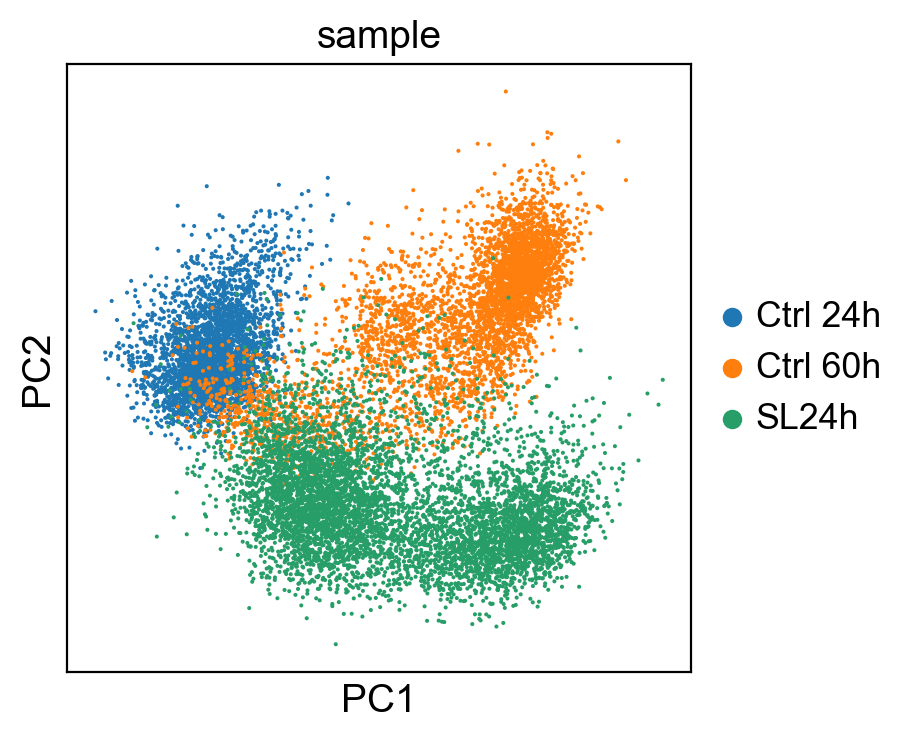

In [32]:
#scatter in the PCA coordinates, won't be used later on, only for vis
sc.pl.pca(adata, color='sample')

In [33]:
adata

AnnData object with n_obs × n_vars = 13943 × 18099
    obs: 'pred_EML', 'sub_pred_EML', 'stage', 'prediction_score_max', 'pred_psdt', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'discard', 'S_score', 'G2M_score', 'phase', 'n_genes', 'doublet_score', 'predicted_doublet'
    var: 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'sample_colors', 'scrublet', 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts'

In [34]:
#Aswin
#correlation score to check influence of cell cycle phase on the PCA
pc1 = adata.obsm['X_pca'][:,0]
corr_s   = np.corrcoef(pc1, adata.obs['S_score'])[0,1]
corr_g2m = np.corrcoef(pc1, adata.obs['G2M_score'])[0,1]
print(f"PC1 vs S_score corr:   {corr_s:.2f}")
print(f"PC1 vs G2M_score corr: {corr_g2m:.2f}")


PC1 vs S_score corr:   0.00
PC1 vs G2M_score corr: 0.00


In [35]:
#Aswin
# extract PC2
pc2_reg = adata.obsm['X_pca'][:,1]

# correlations
corr_s_reg   = np.corrcoef(pc2_reg, adata.obs['S_score'])[0,1]
corr_g2m_reg = np.corrcoef(pc2_reg, adata.obs['G2M_score'])[0,1]

print(f"Regressed PC2 vs S_score corr:   {corr_s_reg:.2f}")
print(f"Regressed PC2 vs G2M_score corr: {corr_g2m_reg:.2f}")


Regressed PC2 vs S_score corr:   0.00
Regressed PC2 vs G2M_score corr: 0.00


In [36]:
pc2_pre = adata.obsm['X_pca'][:,1]
corr_s_pre   = np.corrcoef(pc2_pre, adata.obs['S_score'])[0,1]
corr_g2m_pre = np.corrcoef(pc2_pre, adata.obs['G2M_score'])[0,1]
print(f"Pre-regression PC2 vs S_score corr:   {corr_s_pre:.2f}")
print(f"Pre-regression PC2 vs G2M_score corr: {corr_g2m_pre:.2f}")

Pre-regression PC2 vs S_score corr:   0.00
Pre-regression PC2 vs G2M_score corr: 0.00


In [37]:
#Aswin
#proportion of cells in different cell phase

phase_counts = adata.obs['phase'].value_counts(normalize=True) * 100
print(phase_counts)

phase
S      53.094743
G2M    46.776160
G1      0.129097
Name: proportion, dtype: float64


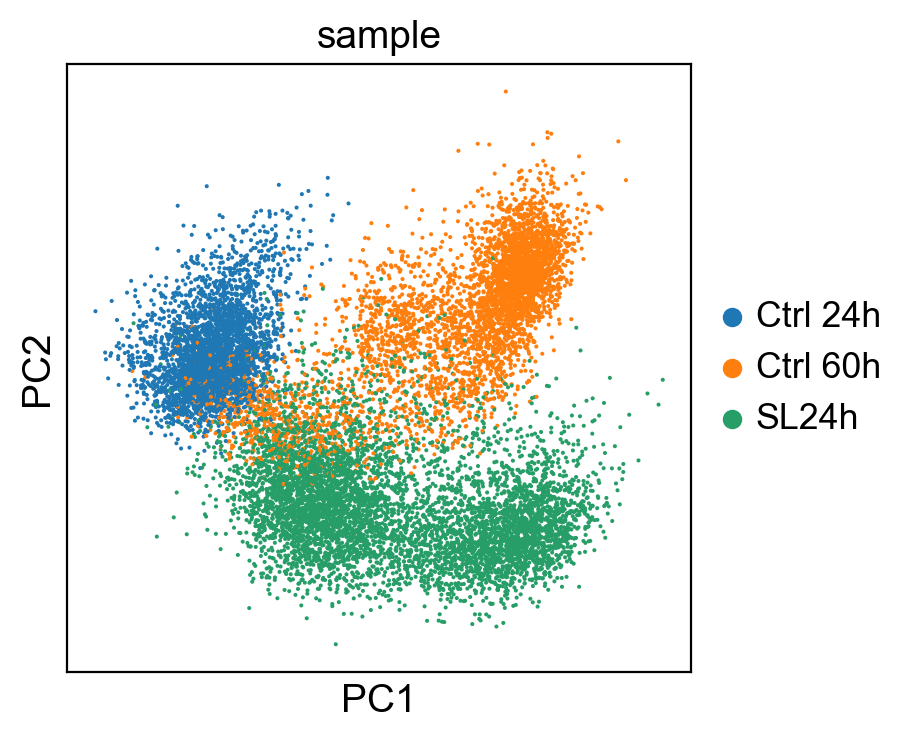

In [38]:
#Aswin-----
#samples plotted in random order
perm = np.random.permutation(adata.n_obs)
adata_shuffled = adata[perm].copy()
sc.pl.pca(adata_shuffled, color='sample')

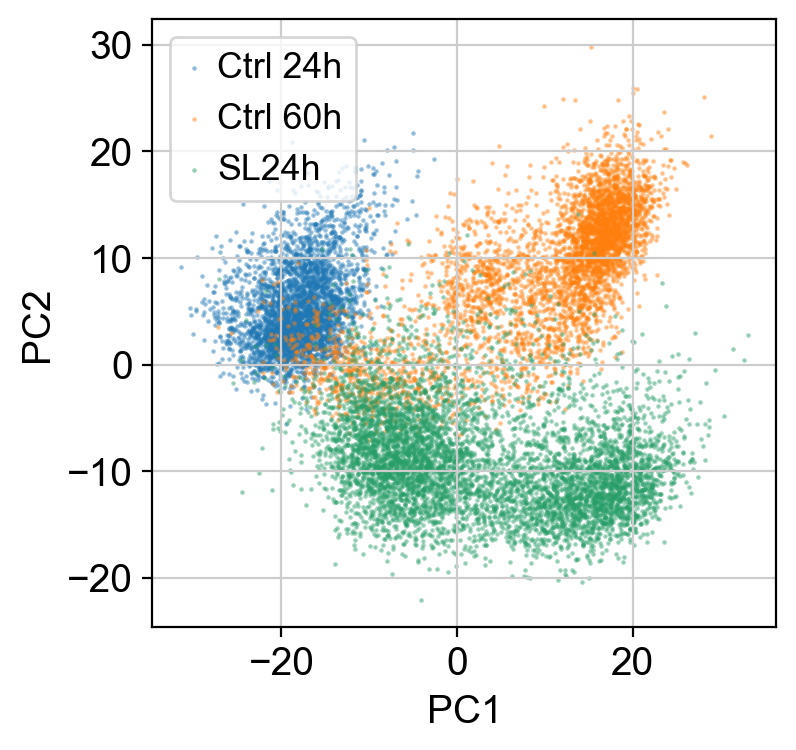

In [39]:
#Aswin-----
#samples plotted with transparency so that the extent of overlap can be visualized
fig, ax = plt.subplots()
for sample, color in zip(['Ctrl 24h','Ctrl 60h','SL24h'], ['C0','C1','C2']):
    idx = adata.obs['sample'] == sample
    ax.scatter(
        adata.obsm['X_pca'][idx,0],
        adata.obsm['X_pca'][idx,1],
        s=0.5, #point size
        c=color,
        label=sample,
        alpha=0.4  # transparency control
    )
ax.legend()
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
plt.show()

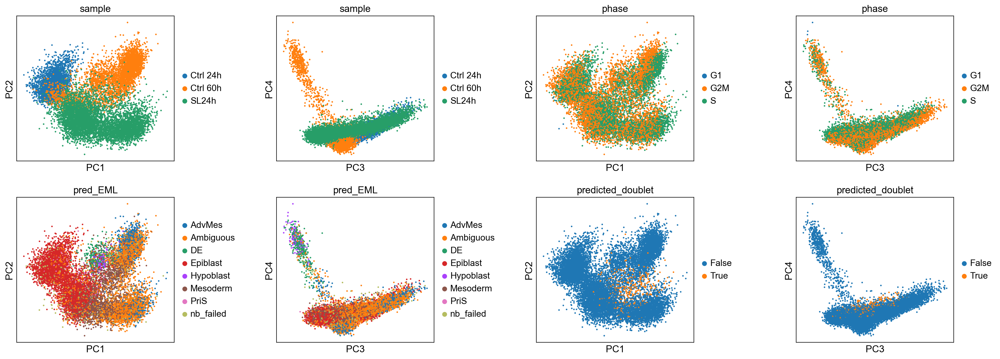

In [40]:
sc.pl.pca(
    adata,
    color=["sample", "sample", "phase", "phase", "pred_EML", "pred_EML", "predicted_doublet", "predicted_doublet"],
    dimensions=[(0, 1), (2, 3), (0, 1), (2, 3), (0, 1), (2, 3), (0, 1), (2, 3)],
    ncols=4,
    wspace=0.5,
    size=20,
)

In [41]:
adata = adata[adata.obs["predicted_doublet"]==False]

# Batch Correction

In [42]:
# Before running integration, save uncorrected data

sc.pp.neighbors(adata, n_neighbors=20, n_pcs=27)
# Calculate umap and tsne.
sc.tl.umap(adata)
sc.tl.tsne(adata)


adata.obsm['X_umap_uncorr'] = adata.obsm['X_umap']
adata.obsm['X_tsne_uncorr'] = adata.obsm['X_tsne']

computing neighbors
    using 'X_pca' with n_pcs = 27
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:08)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:10)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm)
    'tsne', tSNE parameters (adata.uns) (0:01:06)


In [43]:
import scanpy.external as sce

sce.pp.harmony_integrate(adata, key="sample")

2025-08-04 19:05:58,913 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-08-04 19:06:03,592 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-08-04 19:06:03,667 - harmonypy - INFO - Iteration 1 of 10
2025-08-04 19:06:06,576 - harmonypy - INFO - Iteration 2 of 10
2025-08-04 19:06:09,152 - harmonypy - INFO - Converged after 2 iterations


## Nearest neighbour graph constuction and visualization

In [44]:
#computing the neighborhood graph
# the number of n_pcs can change. Based on the QC values used before, It suggested to use 25. 
# the number of n_neighbors can also change and will need to be obtimised. For now use 20. 
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=27, use_rep='X_pca_harmony')

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


In [45]:
# Calculate the umap and tsne.
sc.tl.umap(adata)
sc.tl.tsne(adata, use_rep='X_pca_harmony')

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:09)
computing tSNE
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm)
    'tsne', tSNE parameters (adata.uns) (0:01:22)


<Axes: title={'center': 'Harmony umap'}, xlabel='UMAP1', ylabel='UMAP2'>

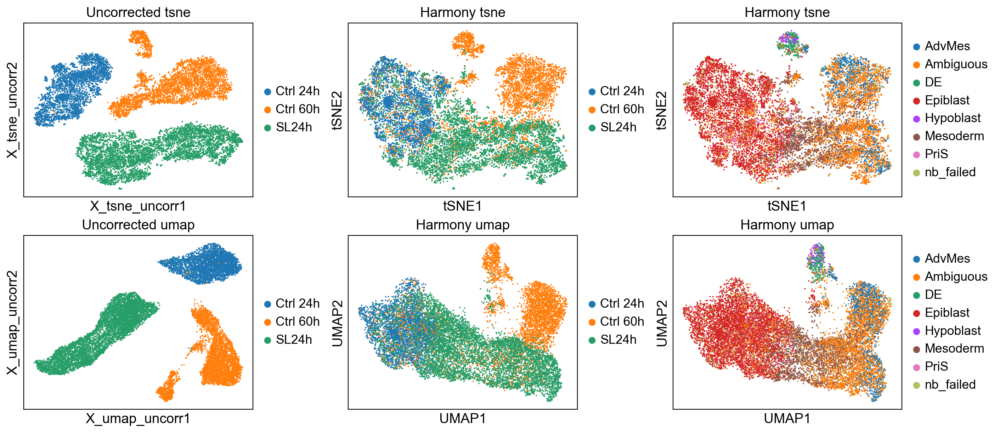

In [46]:
fig, axs = plt.subplots(2, 3, figsize=(14,6),constrained_layout=True)
sc.pl.embedding(adata, "X_tsne_uncorr",color="sample", title="Uncorrected tsne", ax=axs[0,0], show=False)
sc.pl.tsne(adata, color="sample", title="Harmony tsne", ax=axs[0,1], show=False)
sc.pl.tsne(adata, color="pred_EML", title="Harmony tsne", ax=axs[0,2], show=False)
sc.pl.embedding(adata, "X_umap_uncorr",color="sample", title="Uncorrected umap", ax=axs[1,0], show=False)
sc.pl.umap(adata, color="sample", title="Harmony umap", ax=axs[1,1], show=False)
sc.pl.umap(adata, color="pred_EML", title="Harmony umap", ax=axs[1,2], show=False)

<Axes: title={'center': 'Harmony umap'}, xlabel='UMAP1', ylabel='UMAP2'>

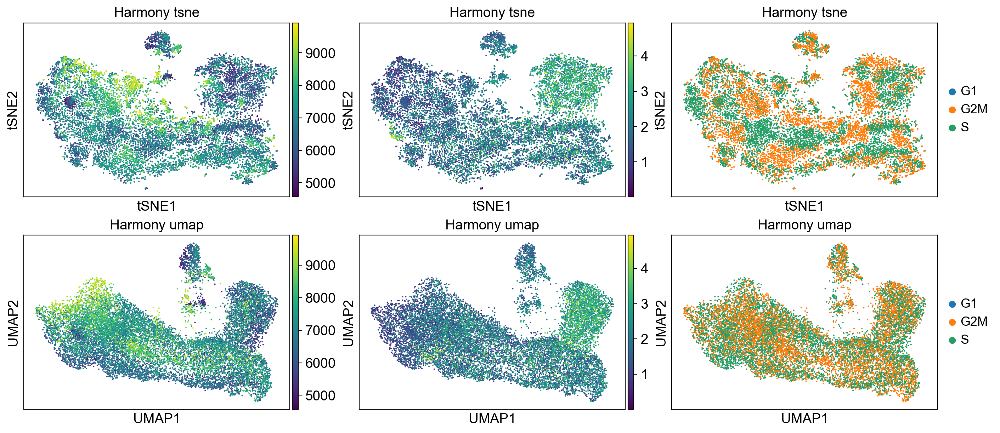

In [47]:
fig, axs = plt.subplots(2, 3, figsize=(14,6),constrained_layout=True)
sc.pl.tsne(adata, color="n_genes_by_counts", title="Harmony tsne", ax=axs[0,0], show=False)
sc.pl.tsne(adata, color="pct_counts_mt", title="Harmony tsne", ax=axs[0,1], show=False)
sc.pl.tsne(adata, color="phase", title="Harmony tsne", ax=axs[0,2], show=False)
sc.pl.umap(adata, color="n_genes_by_counts", title="Harmony umap", ax=axs[1,0], show=False)
sc.pl.umap(adata, color="pct_counts_mt", title="Harmony umap", ax=axs[1,1], show=False)
sc.pl.umap(adata, color="phase", title="Harmony umap", ax=axs[1,2], show=False)

## Clustering

In [48]:
# calculating leiden coordinates
sc.tl.leiden(adata, key_added="leiden_res0_4", resolution=0.4)
sc.tl.leiden(adata, key_added="leiden_res0_6", resolution=0.6)
sc.tl.leiden(adata, key_added="leiden_res0_8", resolution=0.8)

running Leiden clustering


/var/folders/3z/44zgxsds7f56xft3hx3b3vkr0000gn/T/ipykernel_1750/3156351887.py:2: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, key_added="leiden_res0_4", resolution=0.4)


    finished: found 6 clusters and added
    'leiden_res0_4', the cluster labels (adata.obs, categorical) (0:00:09)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_res0_6', the cluster labels (adata.obs, categorical) (0:00:08)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden_res0_8', the cluster labels (adata.obs, categorical) (0:00:07)


In [49]:
sc.tl.leiden(adata, key_added="leiden_res1", resolution=1)

running Leiden clustering
    finished: found 14 clusters and added
    'leiden_res1', the cluster labels (adata.obs, categorical) (0:00:11)


<Axes: title={'center': 'Harmony umap'}, xlabel='UMAP1', ylabel='UMAP2'>

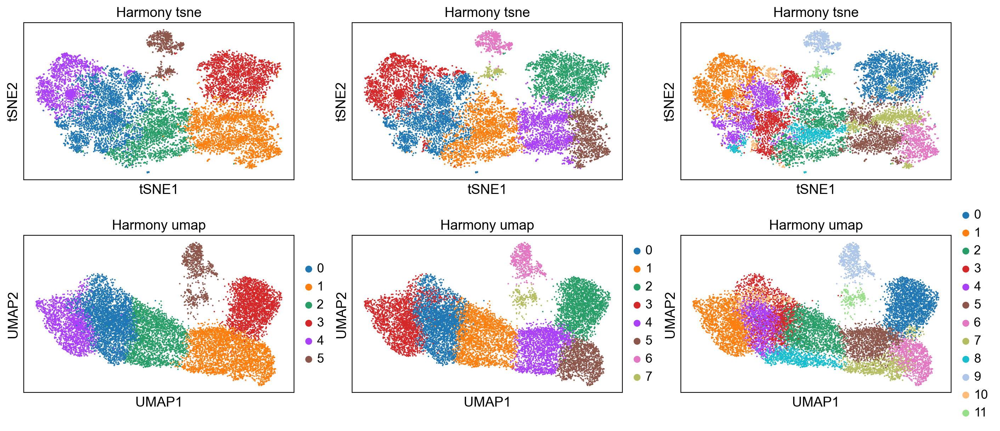

In [50]:
fig, axs = plt.subplots(2, 3, figsize=(14,6),constrained_layout=True)
sc.pl.tsne(adata, color="leiden_res0_4", title="Harmony tsne", ax=axs[0,0], show=False, legend_loc=None)
sc.pl.tsne(adata, color="leiden_res0_6", title="Harmony tsne", ax=axs[0,1], show=False, legend_loc=None)
sc.pl.tsne(adata, color="leiden_res0_8", title="Harmony tsne", ax=axs[0,2], show=False, legend_loc=None)
sc.pl.umap(adata, color="leiden_res0_4", title="Harmony umap", ax=axs[1,0], show=False)
sc.pl.umap(adata, color="leiden_res0_6", title="Harmony umap", ax=axs[1,1], show=False)
sc.pl.umap(adata, color="leiden_res0_8", title="Harmony umap", ax=axs[1,2], show=False)

In [51]:
# Let's choose res 0.8
clustering_res = 'leiden_res0_8'


#### First pass differential gene expression analysis between clusters

In [52]:
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(adata, groupby=clustering_res)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


In [53]:
sc.tl.dendrogram(adata, groupby=clustering_res)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_res0_8']`


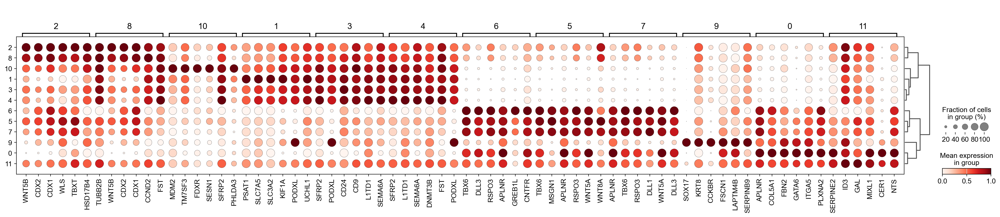

In [55]:
sc.pl.rank_genes_groups_dotplot(adata, groupby=clustering_res, standard_scale="var", n_genes=6)


#### Export the top 50 DEGs for each cluster to files

In [56]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
ranks = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores']})
ranks.iloc[:50,:].to_csv('top_50_leiden0_8.csv')

In [76]:
## Helpful to visualise genes by score for each cluster
#sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)


#### Pairwise comparison to further gain insights into differences between related clusters

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


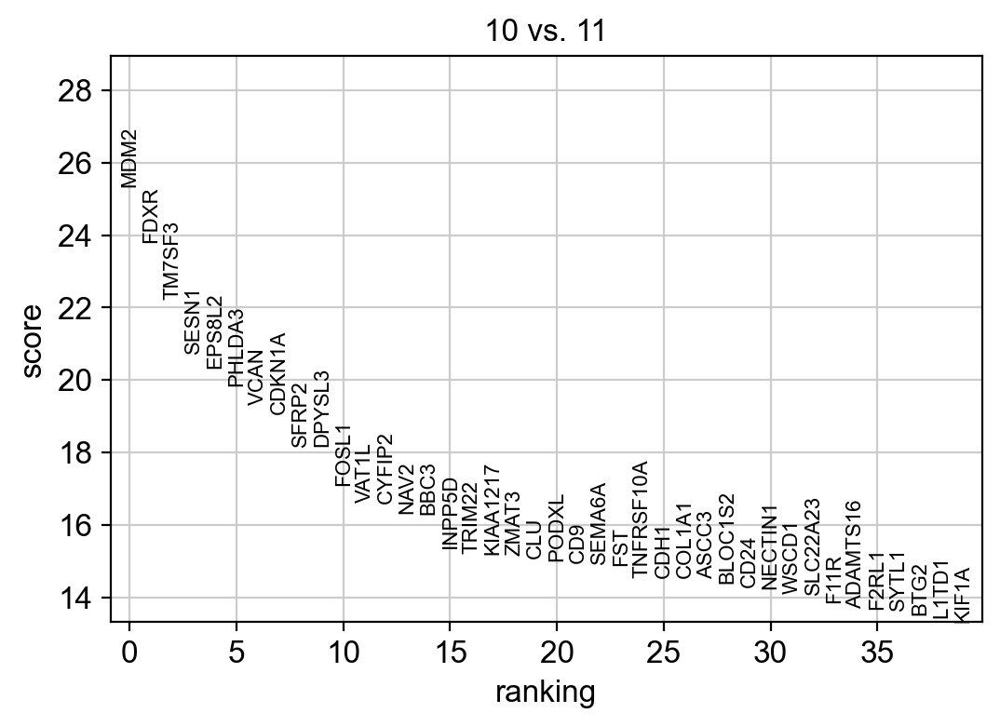

In [57]:
## Can be used to compare two clusters with one another
# Just change the cluster groups below to make any specific pariwise comparison

sc.set_figure_params(
    dpi=100,               # Resolution
    figsize=(6,4),        # Default figure size
    fontsize=12,           # Font size
    frameon=False          # Remove frames
)

sc.tl.rank_genes_groups(adata, clustering_res, groups=["10"], reference="11")
sc.pl.rank_genes_groups(adata, groups=["10"], n_genes=40)

#### Plot some known key markers

<Axes: title={'center': 'FOXA2'}, xlabel='UMAP1', ylabel='UMAP2'>

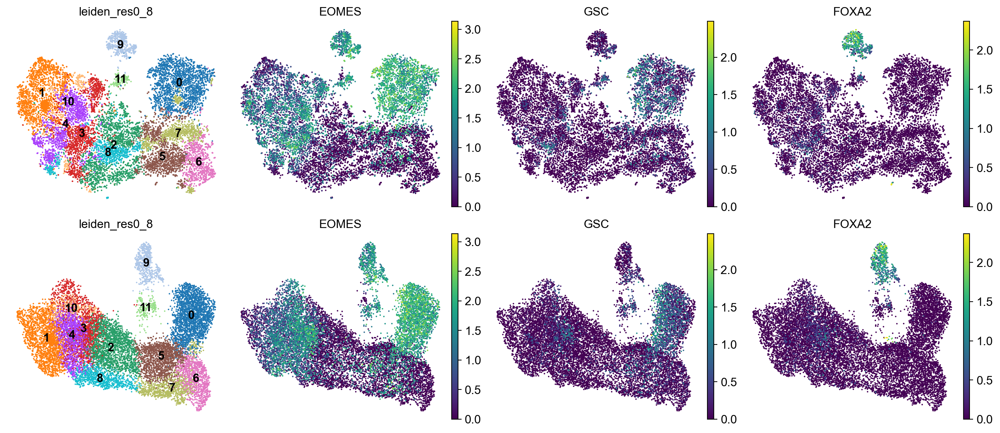

In [58]:
gene1="EOMES"
gene2="GSC"
gene3="FOXA2"

fig, axs = plt.subplots(2, 4, figsize=(14,6),constrained_layout=True)
sc.pl.tsne(adata, color=clustering_res, ax=axs[0,0], show=False, legend_loc='on data')
sc.pl.tsne(adata, color=gene1, ax=axs[0,1], show=False)
sc.pl.tsne(adata, color=gene2,  ax=axs[0,2], show=False)
sc.pl.tsne(adata, color=gene3,  ax=axs[0,3], show=False)
sc.pl.umap(adata, color=clustering_res, ax=axs[1,0], show=False, legend_loc='on data')
sc.pl.umap(adata, color=gene1,  ax=axs[1,1], show=False)
sc.pl.umap(adata, color=gene2,  ax=axs[1,2], show=False)
sc.pl.umap(adata, color=gene3,  ax=axs[1,3], show=False)

#### Summary:

   * Somitic mesoderm : clusters 0,4,5,6
     * 5 -> PXM
     * 0 -> ExM
     * 4/6 -> PSM
   * Caud.Mes/NMP? : 8,1
     * NMP based on Wnt5b, Hoxb9 and CDX expression?    
   * APS: 7,3,11
   * En-ExM: 10 
   * Endoderm: 9

In [62]:
# Assign cell typs based on the DEG analysis above
adata.obs["cell_types"] = adata.obs[clustering_res].map(
    {
        "0": "ExM",
        "2": "Caud. Epi.",
        "1": "Epi.",
        "3": "APS",
        "5": "PSM",
        "6": "PXM",
        "7": "PSM",
        "4": "APS",
        "8": "Caud. Epi.",
        "9": "Endoderm",
        "11": "En-EXM",
        "10": "APS",
    }
).astype('category')

### Add NotoPs

[<Axes: title={'center': 'NOTO'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'FOXA2'}, xlabel='UMAP1', ylabel='UMAP2'>]

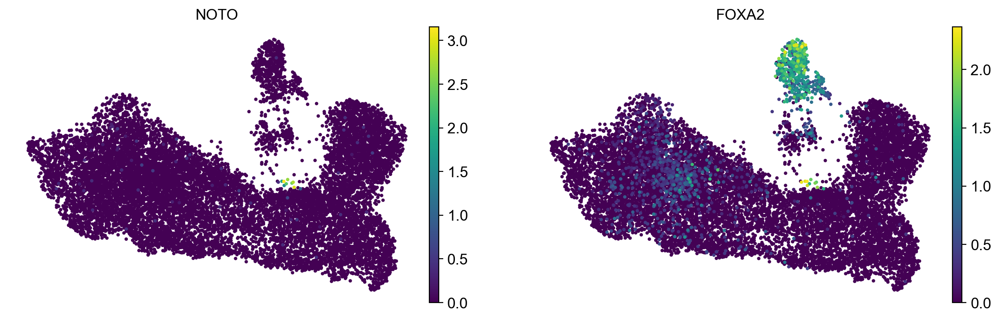

In [63]:
sc.pl.umap(adata, color=["NOTO", "FOXA2"], size=30, show=False)

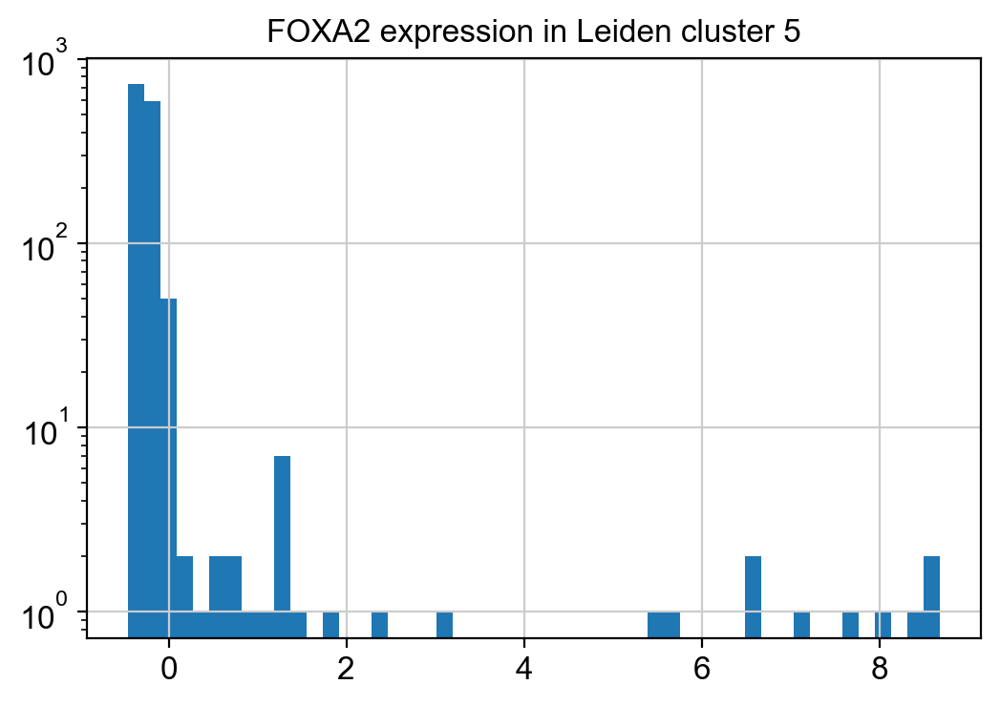

In [64]:
#checking noto expression levels to isolate noto cells
cluster_mask = adata.obs[clustering_res]=='5'
foxa2_vals = adata[cluster_mask, 'FOXA2'].X.toarray().ravel()
plt.hist(foxa2_vals, bins=50, log=True)
plt.title("FOXA2 expression in Leiden cluster 5"); plt.show()

In [65]:
#isolating FoxA2 expressing cells
#threshold
cutoff = 3
is_foxa2 = foxa2_vals > cutoff

#creating notoP category in cell_types
adata.obs['cell_types'] = adata.obs['cell_types'].cat.add_categories(['NotoP'])

cluster_indices = adata.obs.index[cluster_mask]       # all SomMes1 barcodes
adata.obs.loc[cluster_indices[is_foxa2], 'cell_types'] = 'NotoP'

print("Pulled out", is_foxa2.sum(), "cells as NotoP")



Pulled out 11 cells as NotoP


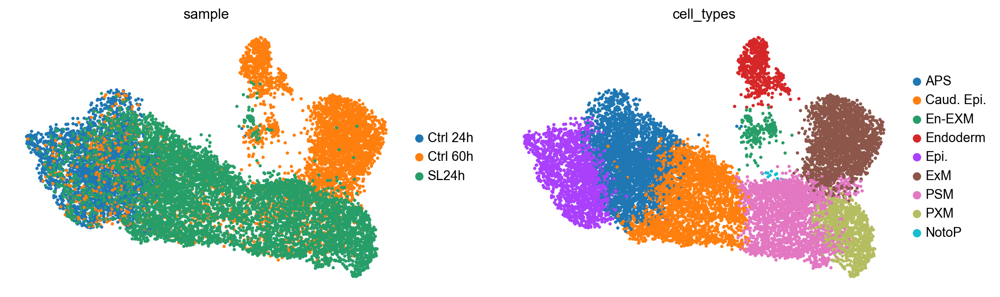

In [66]:
sc.pl.umap(adata, color=["sample","cell_types"], size=30)

### Now check DEG again

In [67]:
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(adata, groupby="cell_types")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


In [68]:
sc.tl.dendrogram(adata, groupby="cell_types")

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_cell_types']`


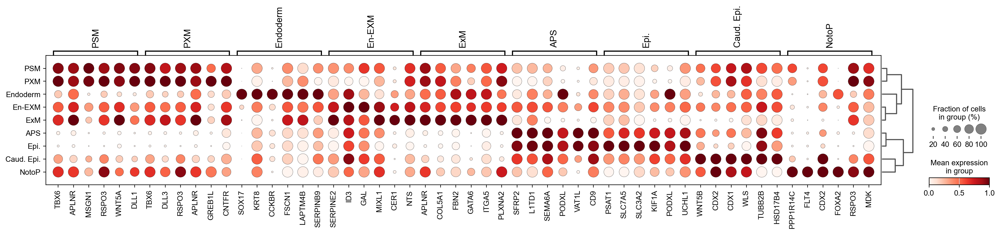

In [69]:
sc.pl.rank_genes_groups_dotplot(adata, groupby="cell_types", standard_scale="var", n_genes=6)


# Pseudotime

In [70]:
sc.tl.diffmap(adata)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9964319  0.9908489  0.9771908  0.9723802  0.96556467
     0.9486193  0.9399901  0.9336416  0.93047786 0.9271824  0.921313
     0.9186051  0.91379654 0.9099866 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)


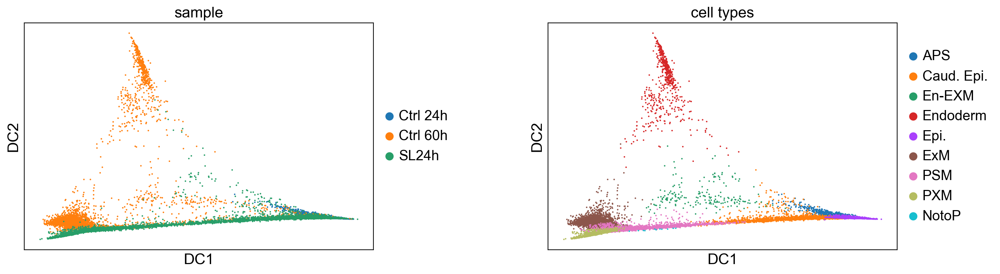

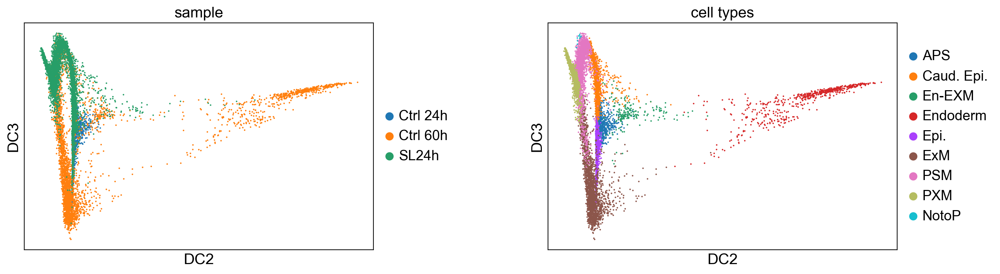

In [71]:

sc.set_figure_params(
    dpi=100,               # Resolution
    figsize=(6,4),        # Default figure size
    fontsize=16,           # Font size
    frameon=True          # Remove frames
)

sc.pl.scatter(
    adata,
    basis="diffmap",
    color=["sample", "cell_types"],
    components=[1, 2],
    size=10
)

sc.pl.scatter(
    adata,
    basis="diffmap",
    color=["sample", "cell_types"],
    components=[2, 3],
    size=10
)

In [ ]:
#identifying diffusion component that separates root cells cleanly from the rest
sc.pl.diffmap(
    adata,
    color="cell_types",               # your annotation column
    components=["1,2"],  
    ncols=2,                        # all plots in one row
    legend_loc="right margin",      # pull the legend out of the way
    size=20                         # dot size
)

In [ ]:
# Setting root cell as described above
root_ixs = adata.obsm["X_diffmap"][:, 8].argmin()
sc.pl.scatter(
    adata,
    basis="tsne",
    color=["cell_types"],
    components=[1, 2],
)

adata.uns["iroot"] = root_ixs

In [81]:
# Setting root cell as highest in DC1
root_ixs = adata.obsm["X_diffmap"][:, 4].argmin()
adata.uns["iroot"] = root_ixs

In [82]:
sc.tl.dpt(adata)

computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


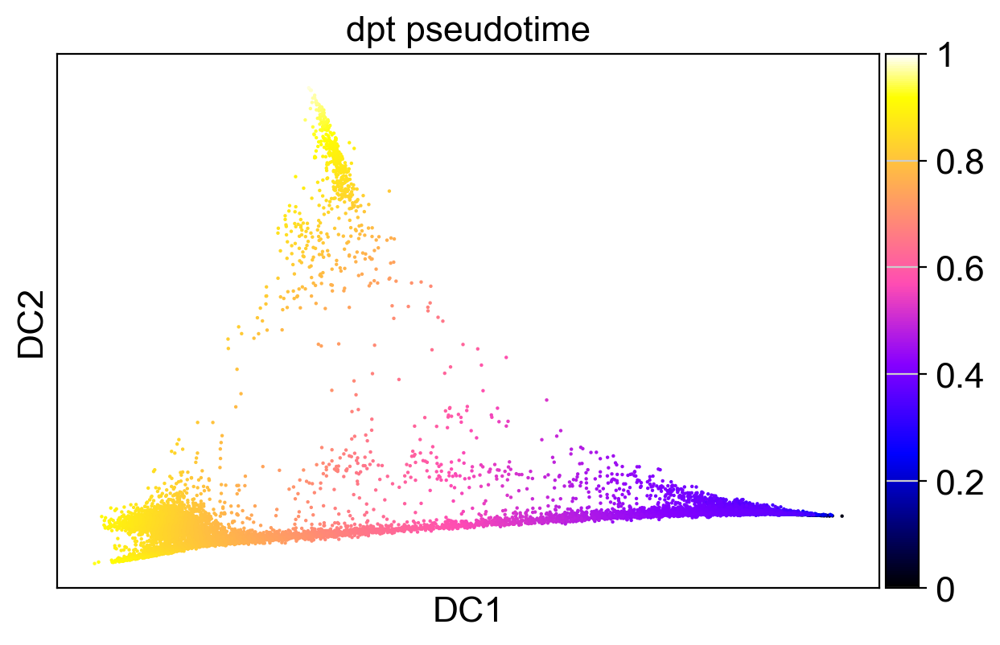

In [83]:
sc.pl.scatter(
    adata,
    basis="diffmap",
    color=["dpt_pseudotime"],
    color_map="gnuplot2",
    size = 10
)

## Trajectory analysis

In [84]:
sc.tl.paga(adata, groups="cell_types")

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)


--> added 'pos', the PAGA positions (adata.uns['paga'])


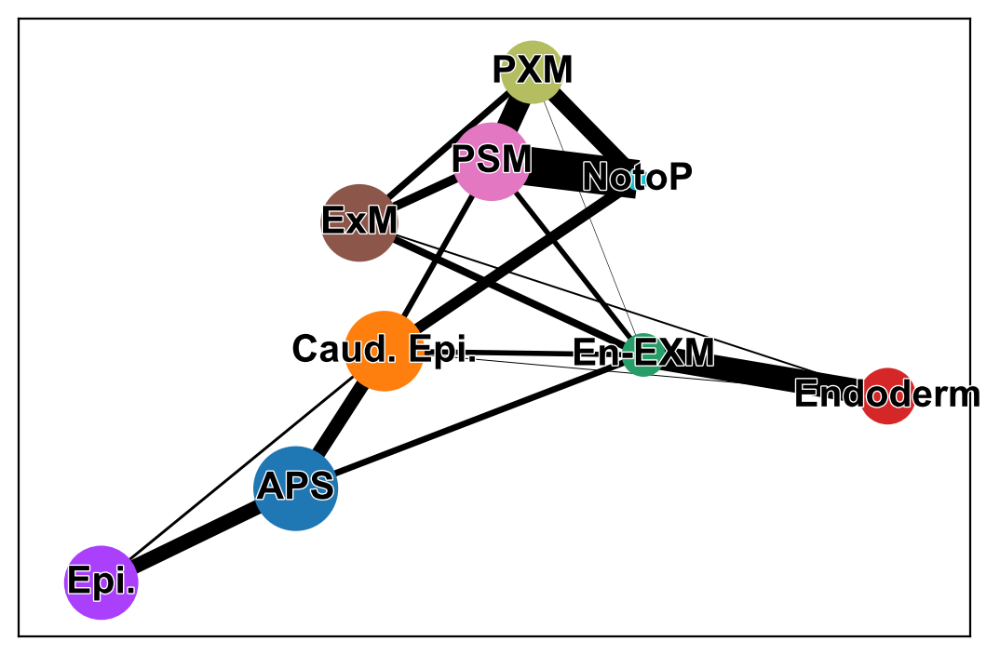

In [85]:
sc.pl.paga(adata, color=["cell_types"], node_size_scale=5, edge_width_scale=2, fontoutline=1)

--> added 'pos', the PAGA positions (adata.uns['paga'])


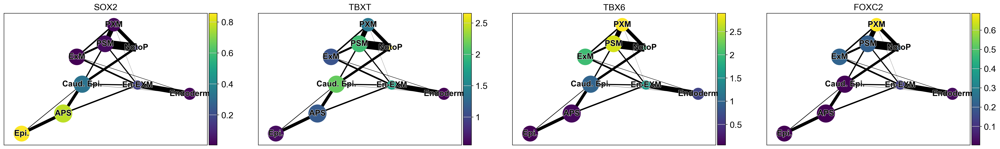

--> added 'pos', the PAGA positions (adata.uns['paga'])


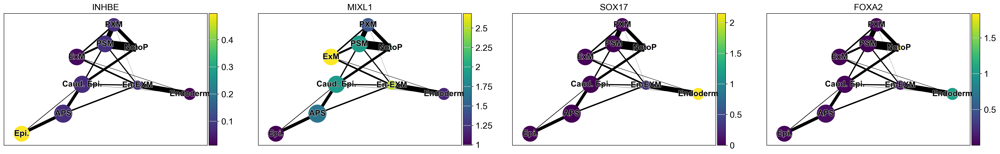

In [86]:
sc.pl.paga(adata, color=["SOX2", "TBXT", "TBX6", "FOXC2"], node_size_scale=5, edge_width_scale=2, fontoutline=1)
sc.pl.paga(adata, color=["INHBE", "MIXL1", "SOX17", "FOXA2"], node_size_scale=5, edge_width_scale=2, fontoutline=1)

In [87]:
paths = [
    ("ExM", ["Epi.", "En-EXM", "ExM"]),
    ("Endo", ["Epi.", "En-EXM", "Endoderm"]),
    ("NotoPs", ["Epi.", "APS", "Caud. Epi.", "NotoP"]),
    ("PXM", ["Epi.", "APS", "Caud. Epi.", "PSM", "PXM"]),
]

/Users/aswinkumaar/anaconda3/lib/python3.11/site-packages/scanpy/plotting/_tools/paga.py:1292: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  groups_axis.set_yticklabels(["", xlabel, ""], fontsize=ytick_fontsize)
/Users/aswinkumaar/anaconda3/lib/python3.11/site-packages/scanpy/plotting/_tools/paga.py:1334: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  anno_axis.set_yticklabels(["", anno, ""], fontsize=ytick_fontsize)


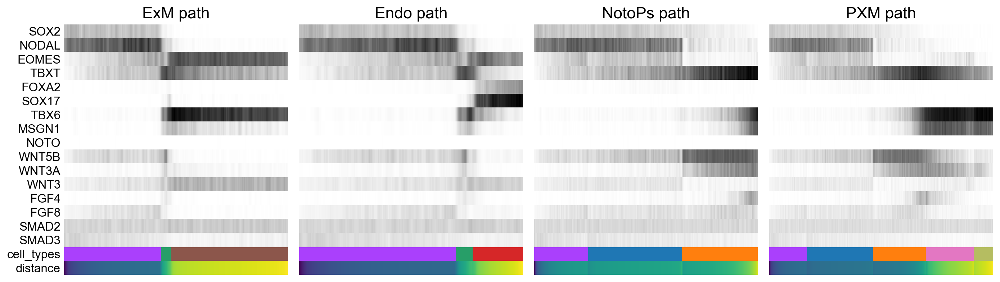

In [88]:
adata.obs["distance"] = adata.obs["dpt_pseudotime"]

gene_names = ["SOX2", "NODAL","EOMES", "TBXT","FOXA2","SOX17","TBX6","MSGN1","NOTO",
             "WNT5B", "WNT3A", "WNT3", "FGF4", "FGF8", "SMAD2", "SMAD3"]

import matplotlib.pyplot as pl


_, axs = pl.subplots(
    ncols=4, figsize=(15, 5), gridspec_kw={"wspace": 0.05, "left": 0.12}
)
pl.subplots_adjust(left=0.05, right=0.98, top=0.82, bottom=0.2)
for ipath, (descr, path) in enumerate(paths):
    data = sc.pl.paga_path(
        adata,
        path,
        gene_names,
        show_node_names=False,
        ax=axs[ipath],
        ytick_fontsize=12,
        left_margin=0.15,
        n_avg=50,
        annotations=["distance"],
        show_yticks=True if ipath == 0 else False,
        show_colorbar=False,
        color_map="Greys",
        groups_key="cell_types",
        color_maps_annotations={"distance": "viridis"},
        title="{} path".format(descr),
        return_data=True,
        show=False,
    )
    #data.to_csv("./write/paga_path_{}.csv".format(descr))

#pl.savefig("./figures/paga_path_paul15.pdf")
pl.show()

/home/ghiomm/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/paga.py:1292: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  groups_axis.set_yticklabels(["", xlabel, ""], fontsize=ytick_fontsize)
/home/ghiomm/.local/lib/python3.11/site-packages/scanpy/plotting/_tools/paga.py:1334: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  anno_axis.set_yticklabels(["", anno, ""], fontsize=ytick_fontsize)


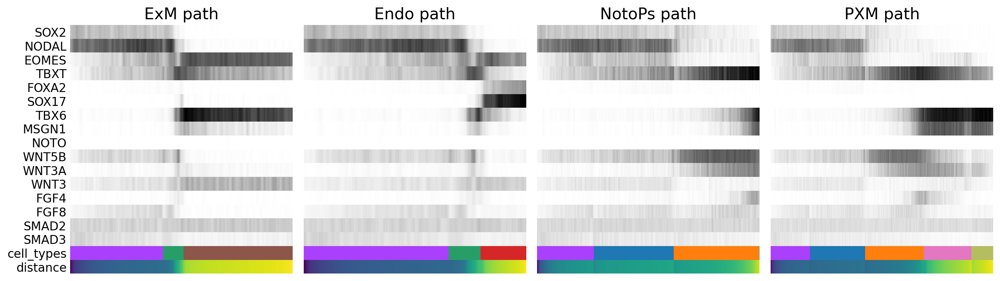

In [199]:
adata.obs["distance"] = adata.obs["dpt_pseudotime"]

gene_names = ["SOX2", "NODAL","EOMES", "TBXT","FOXA2","SOX17","TBX6","MSGN1","NOTO",
             "WNT5B", "WNT3A", "WNT3", "FGF4", "FGF8", "SMAD2", "SMAD3"]

import matplotlib.pyplot as pl


_, axs = pl.subplots(
    ncols=4, figsize=(15, 5), gridspec_kw={"wspace": 0.05, "left": 0.12}
)
pl.subplots_adjust(left=0.05, right=0.98, top=0.82, bottom=0.2)
for ipath, (descr, path) in enumerate(paths):
    data = sc.pl.paga_path(
        adata,
        path,
        gene_names,
        show_node_names=False,
        ax=axs[ipath],
        ytick_fontsize=12,
        left_margin=0.15,
        n_avg=50,
        annotations=["distance"],
        show_yticks=True if ipath == 0 else False,
        show_colorbar=False,
        color_map="Greys",
        groups_key="cell_types",
        color_maps_annotations={"distance": "viridis"},
        title="{} path".format(descr),
        return_data=True,
        show=False,
    )
    #data.to_csv("./write/paga_path_{}.csv".format(descr))

#pl.savefig("./figures/paga_path_paul15.pdf")
pl.show()

In [7]:
print(sc.__version__)

1.11.2
